<a href="https://colab.research.google.com/github/kostique23/TrafficSignDetection/blob/main/TrafficSignDetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Установка и импорт необходимых библиотек

In [ ]:
#@title Установка библиотеки

!pip install -q ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 906.8/906.8 kB 24.7 MB/s eta 0:00:00


In [ ]:
#@title Импортируем библиотеки

import ultralytics

from ultralytics import YOLO
import os
from PIL import Image
import cv2
from IPython.display import Video
import glob
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')


ultralytics.checks()

Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.5/112.6 GB disk)


### Загрузка датасета

In [ ]:
#@title Загрузка

!wget https://storage.yandexcloud.net/academy.ai/CV/traffic_signs_detection.zip

--2025-01-10 18:10:19--  https://storage.yandexcloud.net/academy.ai/CV/traffic_signs_detection.zip
Resolving storage.yandexcloud.net (storage.yandexcloud.net)... 213.180.193.243, 2a02:6b8::1d9
Connecting to storage.yandexcloud.net (storage.yandexcloud.net)|213.180.193.243|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 104699644 (100M) [application/x-zip-compressed]
Saving to: ‘traffic_signs_detection.zip’

traffic_signs_detec 100%[===================>]  99.85M  14.1MB/s    in 8.4s    

2025-01-10 18:10:28 (11.9 MB/s) - ‘traffic_signs_detection.zip’ saved [104699644/104699644]



In [ ]:
#@title Распаковка

!unzip -qo "traffic_signs_detection.zip"
yaml_path = '/content/car/data.yaml'

### Fine-tuning (дообучение модели)

In [ ]:
#@title Загрузим предобученные веса модели small для YOLO v11

model = YOLO('yolo11s.pt')

100%|██████████| 18.4M/18.4M [00:00<00:00, 115MB/s] 


In [ ]:
#@title Запускаем дообучение модели на загруженном датасете с шахматными фигурами

results = model.train(
    data=yaml_path,   # путь к конфигурационному файлу
    epochs=5,        # число эпох
    batch=16,         # размер пакета
    imgsz=416,        # размер входного изображения
    plots= True       # сохранять графики
)

Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=/content/car/data.yaml, epochs=5, time=None, patience=100, batch=16, imgsz=416, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True

100%|██████████| 755k/755k [00:00<00:00, 20.7MB/s]


Overriding model.yaml nc=80 with nc=15

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  6                  -1  1    346112  ultralytics.nn.modules.block.C3k2            [256, 256, 1, True]           
  7                  -1  1   1180672  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 109MB/s]


AMP: checks passed ✅


train: Scanning /content/car/train/labels... 3530 images, 3 backgrounds, 0 corrupt: 100%|██████████| 3530/3530 [00:01<00:00, 2140.95it/s]

train: New cache created: /content/car/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/car/valid/labels... 801 images, 0 backgrounds, 0 corrupt: 100%|██████████| 801/801 [00:00<00:00, 840.03it/s]

val: New cache created: /content/car/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000526, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      2.09G     0.8057      2.666      1.059         16        416: 100%|██████████| 221/221 [00:50<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:06<00:00,  4.27it/s]


                   all        801        944      0.431       0.46      0.417      0.336

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      2.07G      0.711      1.531     0.9919         21        416: 100%|██████████| 221/221 [00:46<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:05<00:00,  4.70it/s]


                   all        801        944       0.51       0.53      0.539      0.432

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5      2.07G     0.6881      1.302     0.9858         19        416: 100%|██████████| 221/221 [00:44<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:06<00:00,  3.99it/s]


                   all        801        944      0.679      0.648      0.695      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      2.09G     0.6668       1.12     0.9745         15        416: 100%|██████████| 221/221 [00:52<00:00,  4.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:04<00:00,  5.66it/s]

                   all        801        944      0.812      0.725      0.791      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      2.08G     0.6137     0.9298      0.953         20        416: 100%|██████████| 221/221 [00:49<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:04<00:00,  5.27it/s]

                   all        801        944      0.887      0.784      0.861       0.73



5 epochs completed in 0.079 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 19.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 19.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,418,605 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:07<00:00,  3.54it/s]


                   all        801        944      0.886      0.783      0.861       0.73
           Green Light         87        122      0.762      0.648      0.696      0.385
             Red Light         74        108      0.855      0.601       0.68      0.406
       Speed Limit 100         52         52      0.903      0.894      0.928       0.82
       Speed Limit 110         17         17      0.667      0.647      0.739       0.68
       Speed Limit 120         60         60      0.942      0.867      0.961      0.853
        Speed Limit 20         56         56       0.93      0.893      0.956      0.792
        Speed Limit 30         71         74      0.876      0.878      0.914      0.839
        Speed Limit 40         53         55      0.911      0.909      0.949      0.826
        Speed Limit 50         68         71       0.91      0.711      0.835      0.737
        Speed Limit 60         76         76      0.917      0.842      0.898      0.791
        Speed Limit 7

### Оценка модели

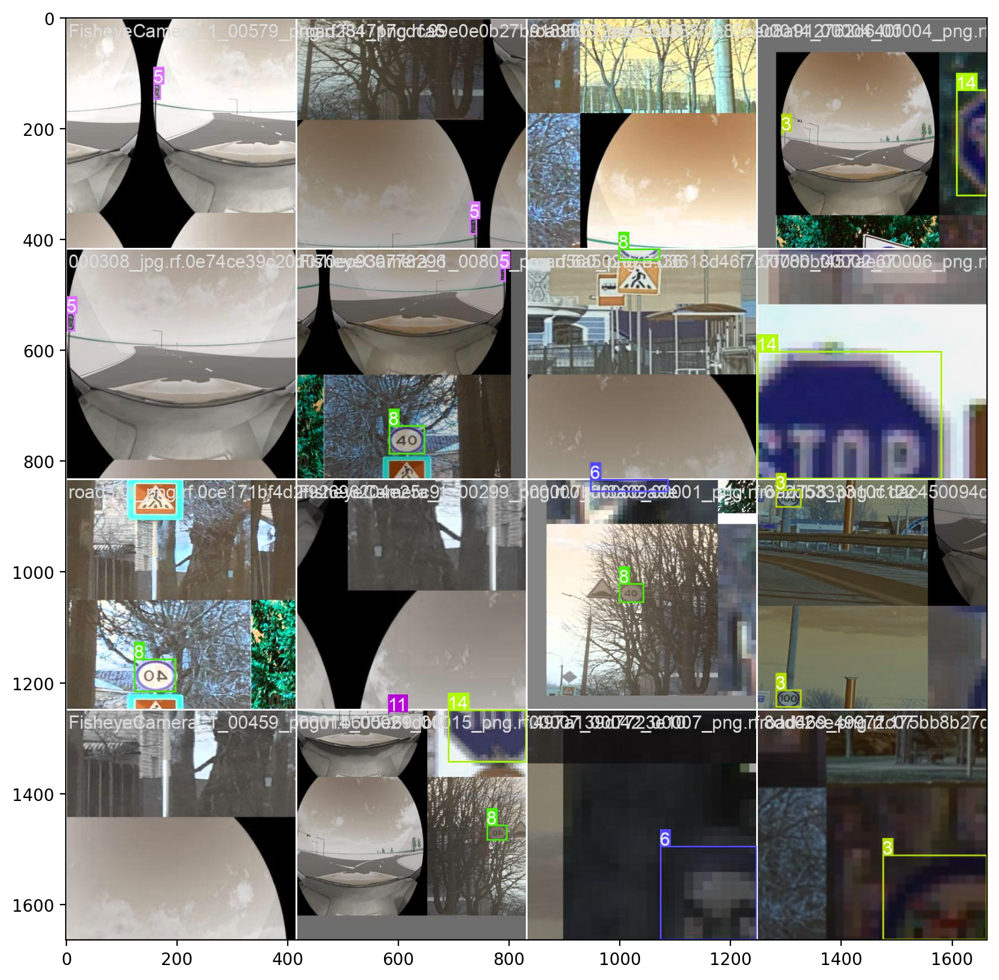

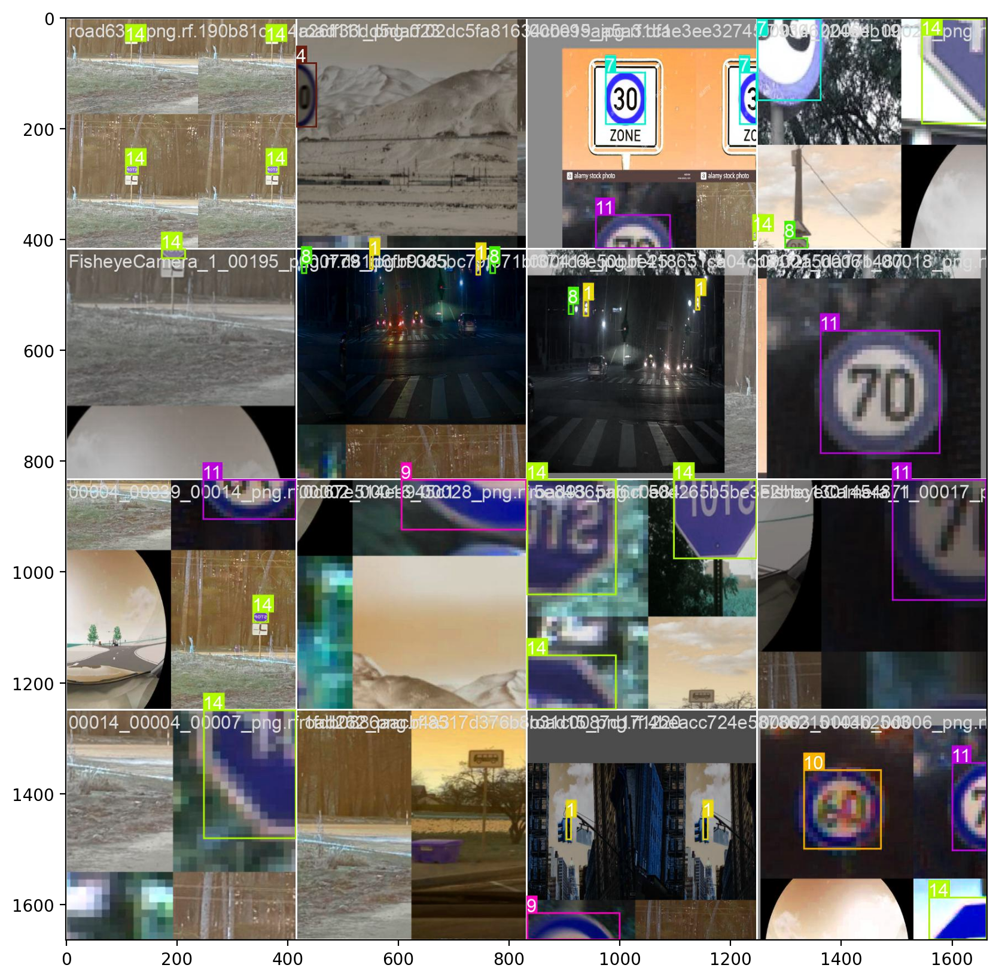

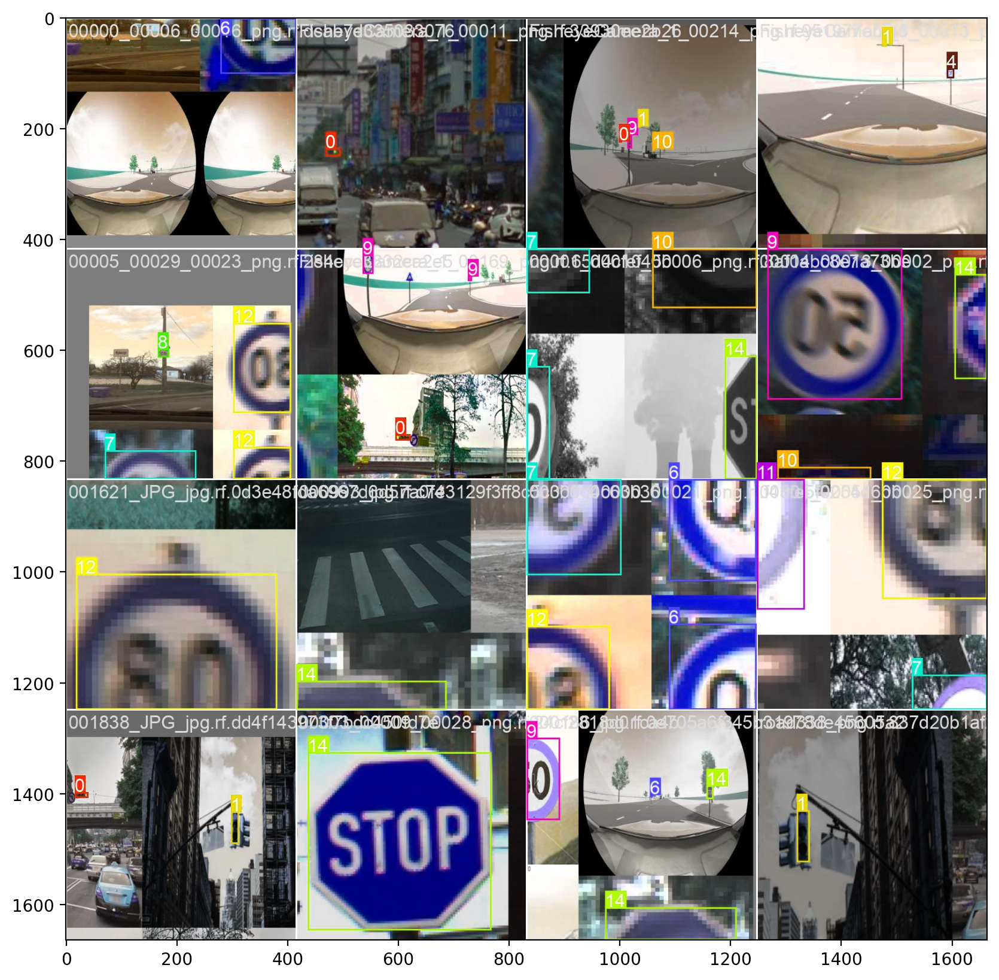

In [ ]:
#@title Детекция на разных эпохах и пакетах

def result_train(path):
    img = cv2.imread(path)
    plt.figure(figsize=(10,10), dpi= 200)
    plt.imshow(img)

data_dir = "./runs/detect/train"
img_dir = os.path.join(data_dir, 'train_batch*.jpg')
files = glob.glob(img_dir)
imgs = []
for image in files:
    result_train(image)

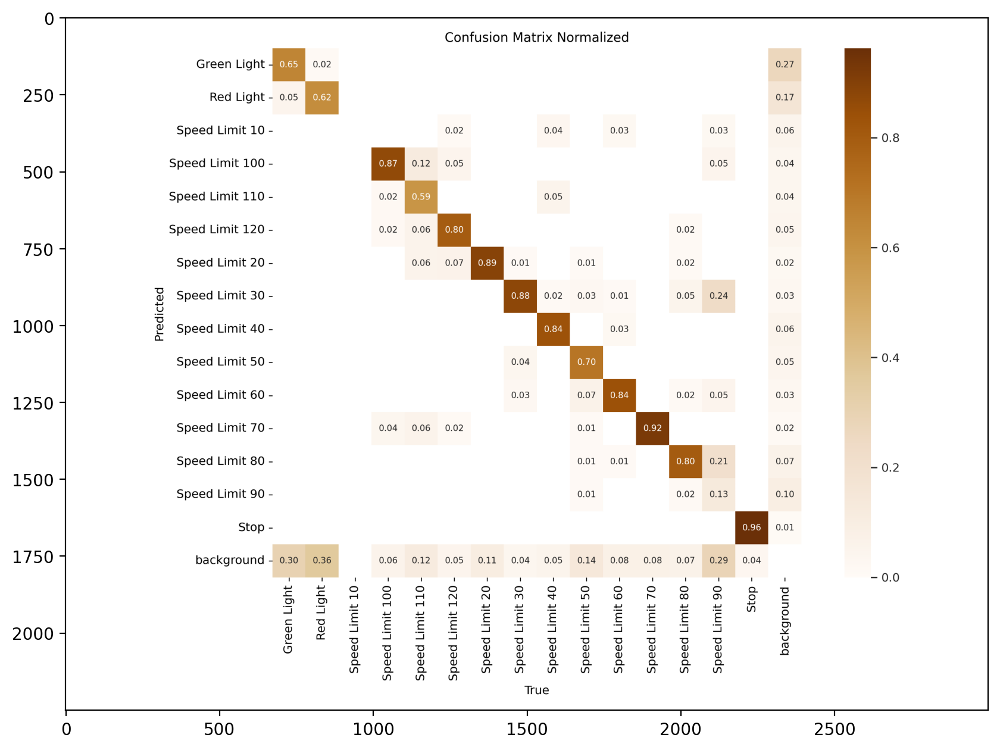

In [ ]:
#@title Матрица ошибок

img_dir = os.path.join(data_dir, 'confusion_matrix_normalized.png')

result_train(img_dir)

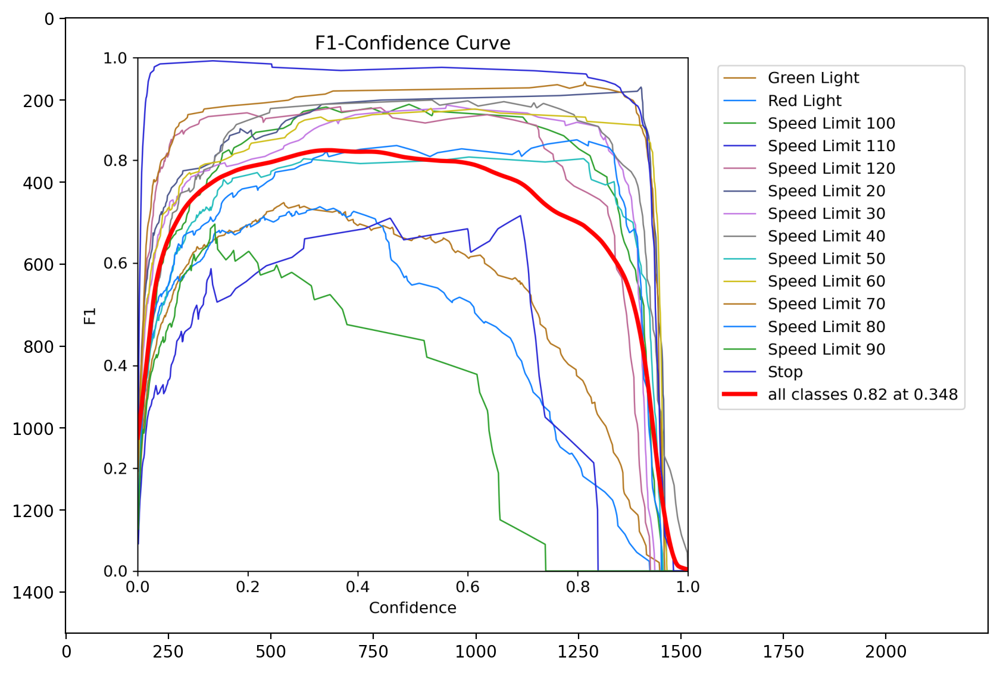

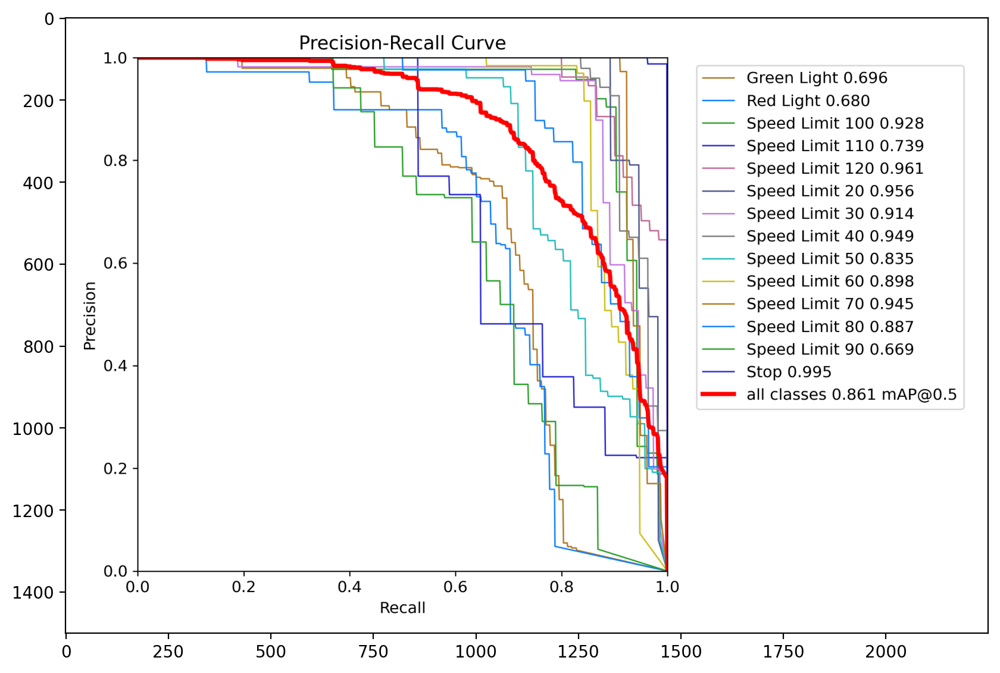

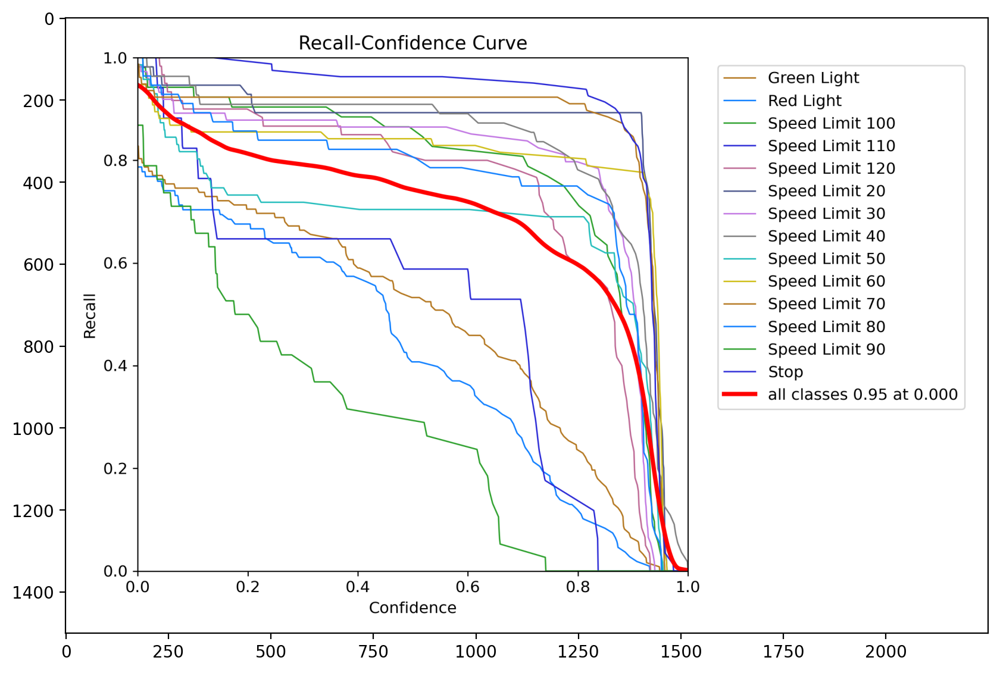

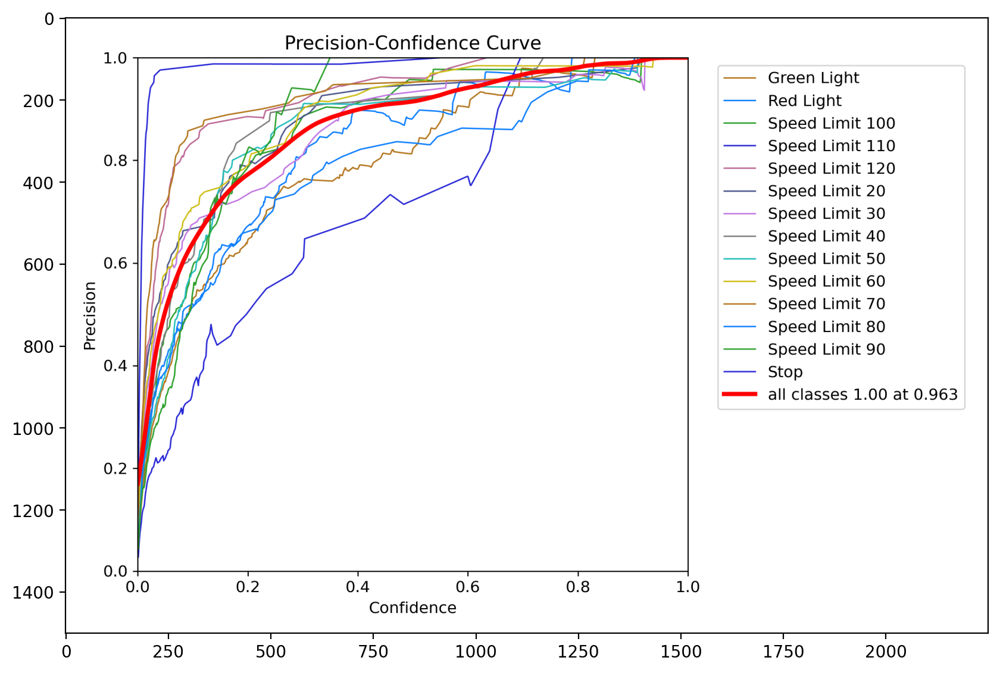

In [ ]:
#@title Вывод различных метрик

data_dir = "./runs/detect/train"
img_dir = os.path.join(data_dir, '*curve*.png')
files = glob.glob(img_dir)
imgs = []
for image in files:
    result_train(image)

In [ ]:
#@title TensorBoard

%load_ext tensorboard
%tensorboard --logdir='./runs/detect/train'

<IPython.core.display.Javascript object>

### Инференс


image 1/1 /content/car/test/images/000866_JPG_jpg.rf.585d575b53d2e6e316c8abb2d07e4c17.jpg: 416x416 1 Green Light, 13.0ms
Speed: 1.3ms preprocess, 13.0ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


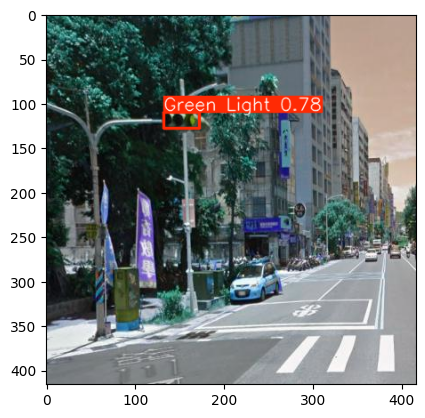


image 1/1 /content/car/test/images/000475_jpg.rf.b44fe1a1d53315f7ff81d3bea0277189.jpg: 416x416 1 Speed Limit 70, 15.2ms
Speed: 1.3ms preprocess, 15.2ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


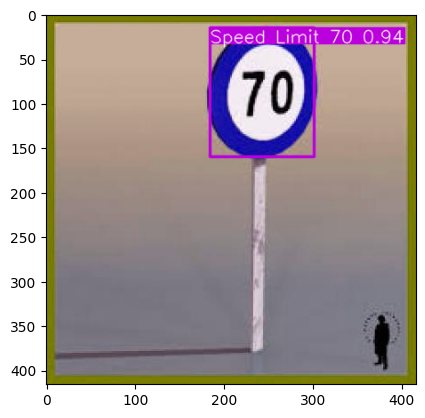


image 1/1 /content/car/test/images/road289_png.rf.ba6012fe8a27d9f53d8d66bb29db5ad8.jpg: 416x416 1 Green Light, 1 Stop, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 416)


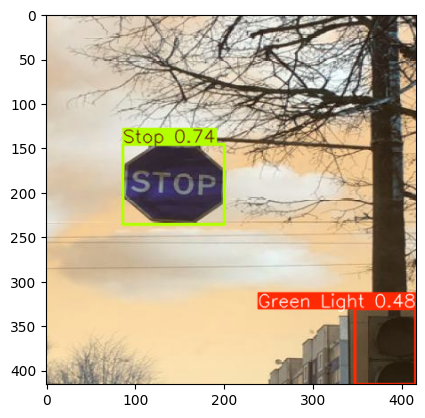


image 1/1 /content/car/test/images/000967_jpg.rf.c03a4af67b2c09d534327ef7de40de4c.jpg: 416x416 2 Red Lights, 13.3ms
Speed: 1.3ms preprocess, 13.3ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


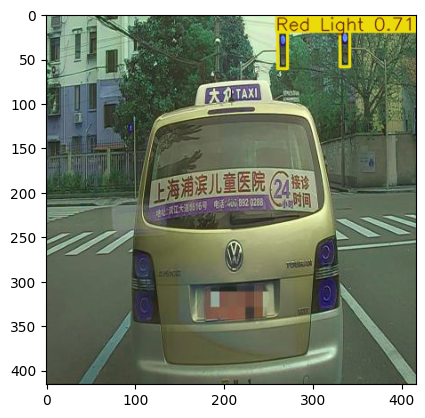


image 1/1 /content/car/test/images/00007_00029_00014_png.rf.cc543e257165aa17476435f594aa76d1.jpg: 416x416 1 Speed Limit 100, 15.9ms
Speed: 1.3ms preprocess, 15.9ms inference, 2.4ms postprocess per image at shape (1, 3, 416, 416)


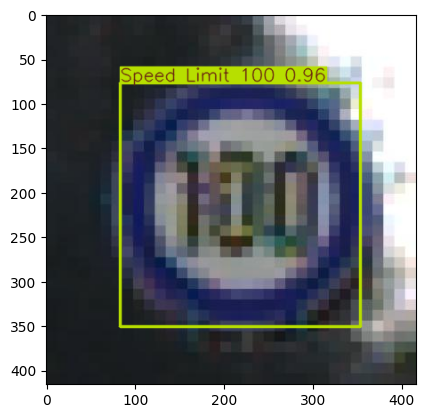


image 1/1 /content/car/test/images/00000_00000_00008_png.rf.ff305dcd6e9ceb9188937311a4a1b207.jpg: 416x416 1 Speed Limit 20, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


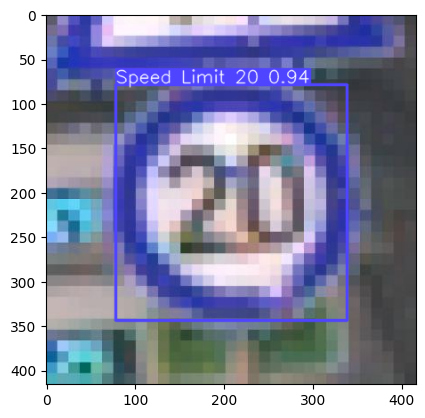


image 1/1 /content/car/test/images/000121_jpg.rf.c26ea4c0be18ece889414f12976c49f2.jpg: 416x416 1 Speed Limit 50, 13.1ms
Speed: 1.3ms preprocess, 13.1ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


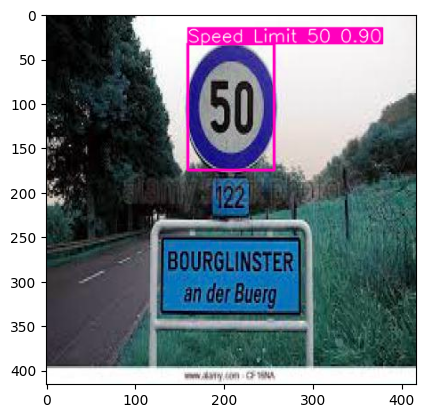


image 1/1 /content/car/test/images/road420_png.rf.4db7dbd13a7b9c37ddddb7df9adf0834.jpg: 416x416 1 Speed Limit 60, 1 Speed Limit 80, 12.7ms
Speed: 1.2ms preprocess, 12.7ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


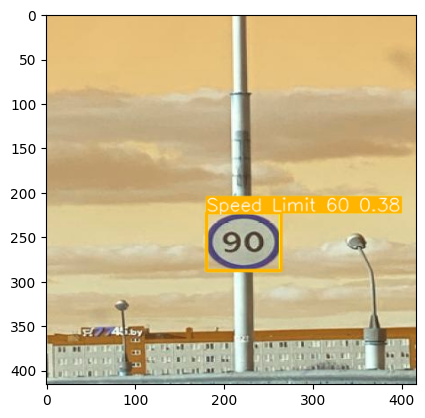


image 1/1 /content/car/test/images/road747_png.rf.66031af78137deac5c6878292d9ce7db.jpg: 416x416 1 Speed Limit 100, 1 Speed Limit 120, 19.7ms
Speed: 1.6ms preprocess, 19.7ms inference, 6.0ms postprocess per image at shape (1, 3, 416, 416)


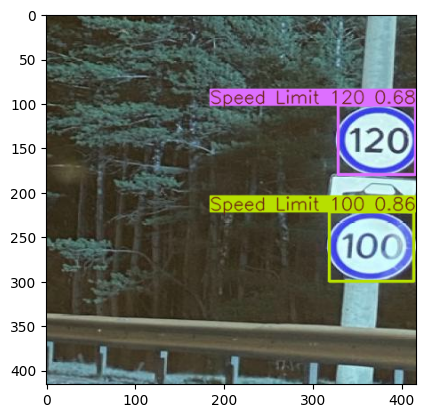


image 1/1 /content/car/test/images/00005_00014_00005_png.rf.0e24dd3583d580dadb9d69e73a08e78c.jpg: 416x416 1 Speed Limit 80, 13.7ms
Speed: 1.7ms preprocess, 13.7ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


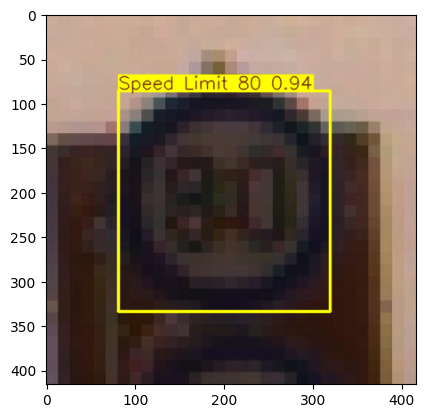

In [ ]:
#@title Эксперимент 1

import random

test_dir = "/content/car/test/images"
img_dir = os.path.join(test_dir, '*.jpg')
files = glob.glob(img_dir)

# Количество случайных изображений для предсказания
num_predictions = 10

for _ in range(num_predictions):  # Цикл для 10 предсказаний
    if not files: # Проверяем, пустой ли список файлов
      print("В тестовом каталоге не найдено файлов JPG.")
      break

    image_test_path = random.choice(files)

    try:  # Добавляем блок try-except для обработки потенциальных ошибок во время предсказания
        pred = model.predict(source=image_test_path, imgsz=416)

        if pred[0].boxes.xyxy is not None and len(pred[0].boxes.xyxy) > 0: #  Проверка наличия обнаруженных объектов
            test_image = pred[0].plot(line_width=2)
            plt.imshow(test_image)
            plt.show()  # Отображаем каждое изображение отдельно
        else:
            print(f"На изображении {image_test_path} не обнаружены объекты.")

    except Exception as e:
        print(f"Ошибка при предсказании на изображении {image_test_path}: {e}")

In [ ]:
#@title Проведем детекции по видео в реальном времени

example_video_path = '/content/video.mp4'

video_output = model.predict(source=example_video_path, conf=0.6, save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/508) /content/video.mp4: 416x416 (no detections), 12.9ms
video 1/1 (frame 2/508) /content/video.mp4: 416x416 (no detections), 14.2ms
video 1/1 (frame 3/508) /content/video.mp4: 416x416 (no detections), 12.0ms
video 1/1 (frame 4/508) /content/video.mp4: 416x416 (no detections), 10.9ms
video 1/1 (frame 5/508) /content/video.mp4: 416x416 1 Stop, 10.8ms
video 1/1 (frame 6/508) /content/video.mp4: 416x416 1 Stop, 14.1ms
video 1/1 (frame 7

In [ ]:
#@title Эксперимент 2

from moviepy.editor import *

path="./runs/detect/train2/video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=960)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4
